# Analysis of users activity 
Authors: Liubov, Samat 


    Example of the depersonalised data analyzed data: 
    59e1f931f6a863670a110000 	2000-10-14 11:46:57.583579+00 	2000-05-03 07:28:10.618613+00 	"nan" 	42.0 	-87.8 	-1 	


In [1]:

import plotly.plotly as py
import plotly.graph_objs as go
import pandas as pd
import csv


# load data, it may be heavy 

df = pd.read_csv('C:/Users/lyubo/Documents/DATA_networks/applications_phone_etc/userssamat/tmp/geo-clean.csv') #samat users
#df.head(5)


In [2]:
print(df.columns)

Index(['59e1f931f6a863670a730000', '2017-10-14 11:46:57.583579+00',
       '2018-05-03 07:28:10.618613+00', '"f"', '42.0611829507639',
       '-87.86498770909681', '-1', 'Unnamed: 7'],
      dtype='object')


In [3]:
print(df.shape)

(1866708, 8)


In [25]:
df.columns = ['id', 'time', 'time2', 'gender', 'lat', 'lon', 'sign', 'nan']

print(df.columns)

#df.head(1)

Index(['id', 'time', 'time2', 'gender', 'lat', 'lon', 'sign', 'nan'], dtype='object')


### Plot trajectories on a map

From 1866708 unique ids of users we plot their distribution on a map.

In [6]:
df_new = df.rename(columns={"59e1f931f6a863670a730000": "id", "2017-10-14 11:46:57.583579+00": "time", "2018-05-03 07:28:10.618613+00": "time2", "f": "gender", "42.0611829507639": "lat", "-87.86498770909681": "lon", "-1": "sign", "Unnamed: 7": "nan"})

In [14]:
from matplotlib import pyplot as plt

# find unique values in column bikeid
ids = np.unique(df_new.id.values)
print('number of unique ids ', len(ids))
df.columns = ['id', 'time', 'time2', 'gender', 'lat', 'lon', 'sign', 'nan']

print(df.columns)


number of unique ids  1866708
Index(['id', 'time', 'time2', 'gender', 'lat', 'lon', 'sign', 'nan'], dtype='object')


In [ ]:
#for ind in range(0, 100):#len(bike_ids)): 
#    df_id = df_new[df_new.id == ids[ind]]
#    print(df_id.lat, df_id.lon)
#    plt.plot(df_id.lat, df_id.lon, 'o')
#plt.show()

C:\Users\lyubo\Anaconda3\envs\default\lib\site-packages\ipykernel_launcher.py:18: MatplotlibDeprecationWarning:


The dedent function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use inspect.cleandoc instead.

C:\Users\lyubo\Anaconda3\envs\default\lib\site-packages\ipykernel_launcher.py:18: MatplotlibDeprecationWarning:


The dedent function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use inspect.cleandoc instead.



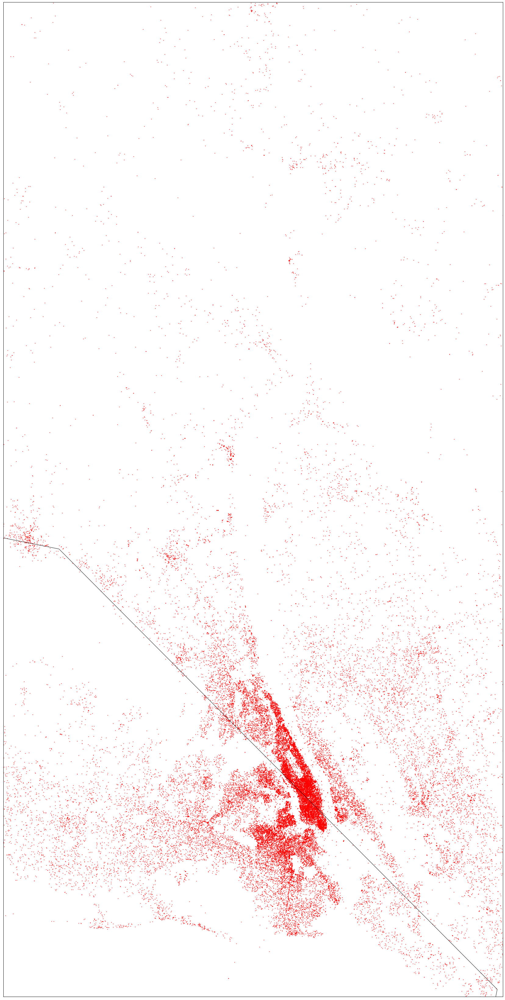

In [5]:

import math
import matplotlib.pyplot as plt

import seaborn
from mpl_toolkits.basemap import Basemap

# setup Lambert Conformal basemap.
# set resolution=None to skip processing of boundary datasets.
# Create a map on which to draw. 
# Use mercator projection, and showing the whole world.

fig, ax = plt.subplots(figsize=(60, 60))

# Berlin Latitude: 52.520008, longitude: 13.404954.
# NYC  40.730610, and the longitude is -73.935242.
# We want to plot only Berlin surrounding areas
m = Basemap(projection='merc',llcrnrlat=40.5,urcrnrlat=41.7,llcrnrlon=-73.5,urcrnrlon=-74.3,lat_ts=20,resolution='c')
# Draw coastlines, and the edges of the map. NASA bluemarble
m.shadedrelief() 
m.bluemarble()
m.drawcoastlines()
m.drawmapboundary()

# Convert latitude and longitude to x and y coordinates
#TODO: verify if x and y correspond well to lon, lat
x, y = m(list(df["lon"].astype(float)), list(df["lat"].astype(float)))

#print(type(x))

# Use matplotlib to draw the points onto the map.
m.scatter(x,y,1,marker='o',color='red')
# Show the plot.
plt.show()

### Geometric graph construction

We need to choose radius for geometric graph

Let us visualise our data as geometric graphs. 
Interesting question here is: 
if geometrical graph constructed from data with the law $E_{ij} = if |V_i, V_j|<R$ for some fixed $R$ overlaps with the connectivity matrix of users $A$, reconstructed from a separate database information.



In [26]:
import numpy as np
from matplotlib import pyplot as plt


def calc_jump_dist(Xarray,Yarray): #function to calculate distribution of steps  # given arrays Xarray, Yarray of trajectories
    dist = np.zeros(len(Xarray))
    for i in range(0, len(Xarray)-1):
        dist[i] = calc_dist(Xarray[i],Xarray[i+1],Yarray[i],Yarray[i+1])
    return dist
    
def calc_dist(x1,x2,y1,y2): #function to calculate distance between 2 points in 2D
    return np.sqrt((x1-x2)*(x1-x2)+(y1-y2)*(y1-y2))


######
'''
set parameters of geometric graph 
x= lat 
y= lon 
verify ;)
'''

radius = 200 # meters 
size = 500 # size of adjacency matrix of geometric graph
geom_net_matr = np.zeros((size, size))

for i in range(0, size): # we check first users from dataframe and plot closest to them 
    user_x = df.lat.iloc[i] #get information about coordinates
    user_y = df.lon.iloc[i] 
    for j in range(0,size): # ideally it should be through all database
        user_i_x =  df.lat.iloc[i] #take coordinates of all other users
        user_i_y =  df.lon.iloc[i]
        #add here additional parameters for comparison
        #if df.lat.iloc[i]        
        if calc_dist(user_x, user_y , user_i_x, user_i_y) < radius: # if users are close enough, connect them
            geom_net_matr[i,j] = 1 
            geom_net_matr[j,i] = 1 #make network non-directed

            
# check also other conditions for coordinates 
#plt.plot(geom_net_matr)
#plt.scatter(geom_net_matr) plot heatmap of matrix
print(geom_net_matr)



[[ 1.  1.  1. ...,  1.  1.  1.]
 [ 1.  1.  1. ...,  1.  1.  1.]
 [ 1.  1.  1. ...,  1.  1.  1.]
 ..., 
 [ 1.  1.  1. ...,  1.  1.  1.]
 [ 1.  1.  1. ...,  1.  1.  1.]
 [ 1.  1.  1. ...,  1.  1.  1.]]


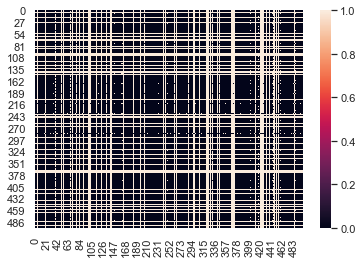

In [13]:

#print(np.nnz(geom_net_matr))
import numpy as np; np.random.seed(0)
import seaborn as sns; sns.set()

import matplotlib.pyplot as plt
%matplotlib inline

#uniform_data = np.random.rand(10, 12)
ax = sns.heatmap(geom_net_matr)
plt.show()

C:\Users\lyubo\Anaconda3\envs\default\lib\site-packages\networkx\drawing\nx_pylab.py:579: MatplotlibDeprecationWarning:


The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.



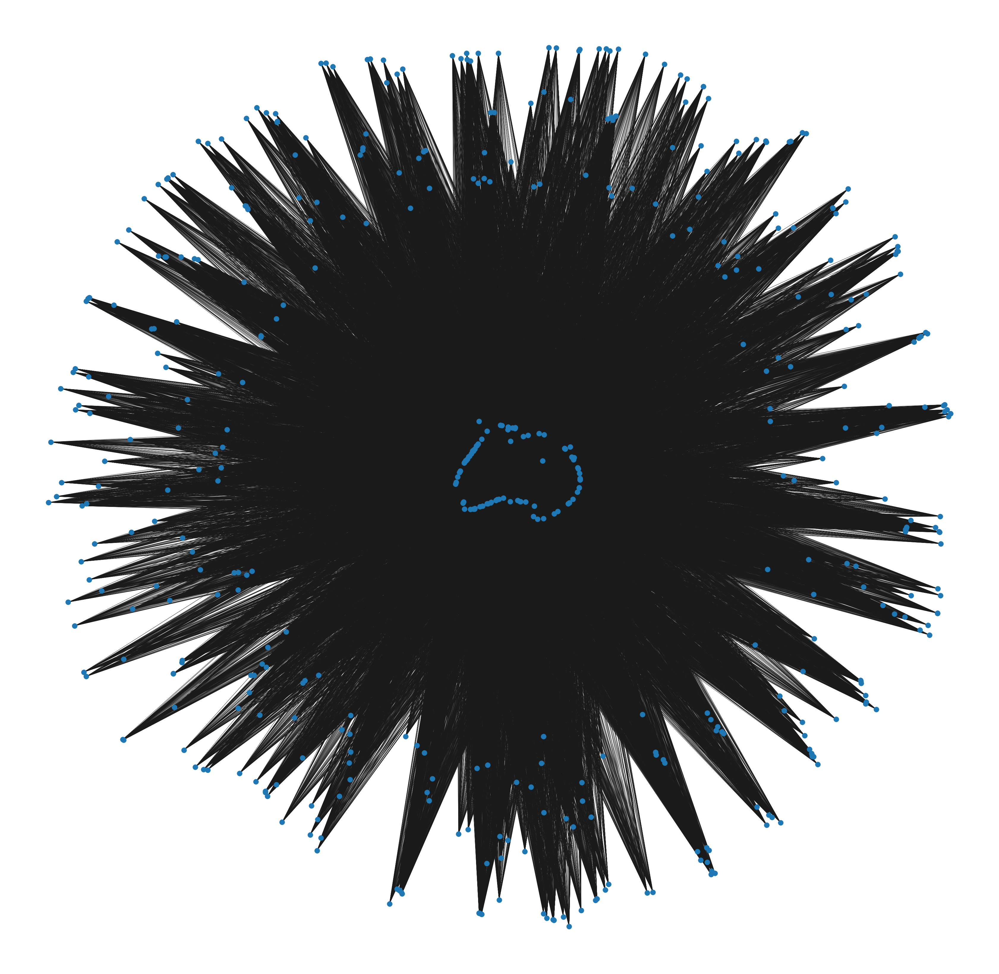

In [14]:

import networkx as nx 
# first we visualise it without any embeddings in 2D space
graph_geom = nx.from_numpy_matrix(geom_net_matr)
pos = nx.get_node_attributes(graph_geom, 'pos')
fig, ax = plt.subplots(figsize=(60, 60))
nx.draw(graph_geom) 
plt.show()

C:\Users\lyubo\Anaconda3\envs\default\lib\site-packages\networkx\drawing\nx_pylab.py:579: MatplotlibDeprecationWarning:


The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.

C:\Users\lyubo\Anaconda3\envs\default\lib\site-packages\networkx\drawing\nx_pylab.py:579: MatplotlibDeprecationWarning:


The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.



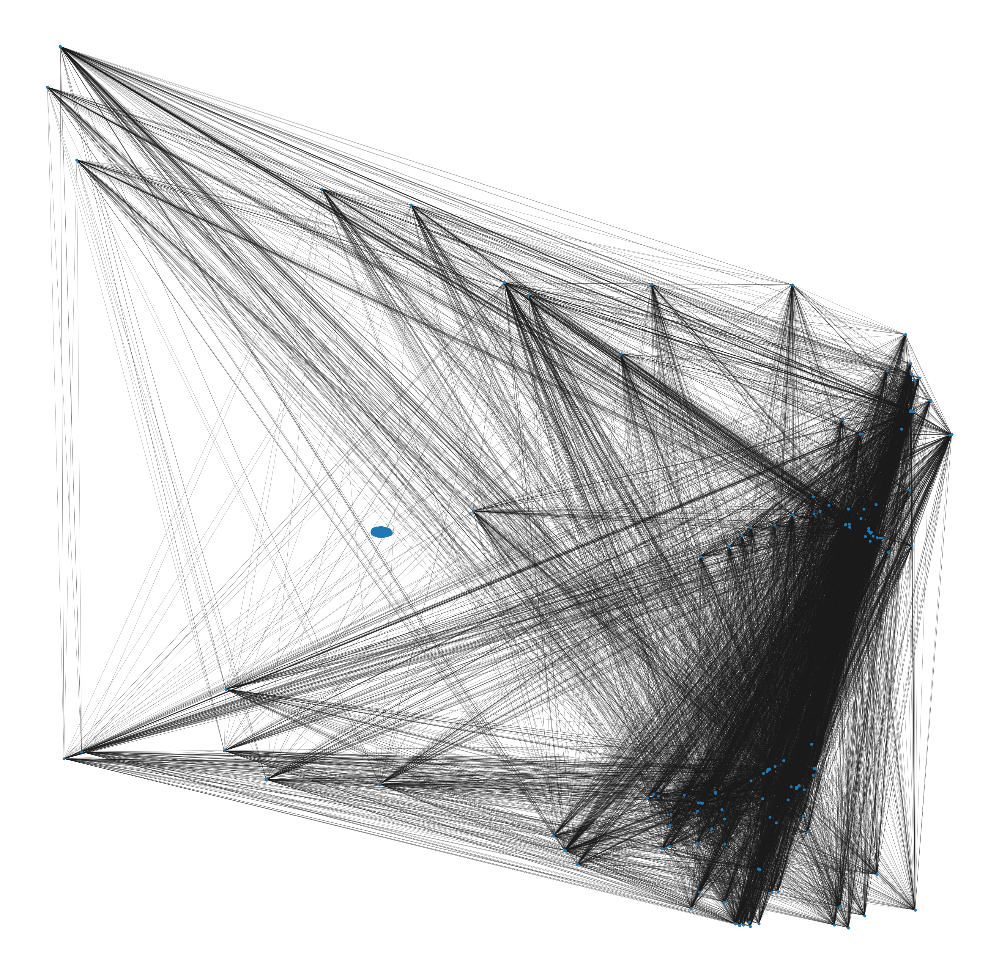

In [28]:
graph_geom = nx.from_numpy_matrix(geom_net_matr)
pos = {} # positions should be dictorionary

for i in range(0, size): # we check first users from dataframe and plot closest to them 
    pos[i] = [df.lat.iloc[i],df.lon.iloc[i]] #get information about coordinates 


#positions for geometric graph nx.get_node_attributes(graph_geom, 'pos')
fig, ax = plt.subplots(figsize=(60, 60))
nx.draw(graph_geom) 
#plot nodes with positions from pos dictionary 
subgraph = graph_geom.subgraph(p.keys())  
nx.draw_networkx_nodes(subgraph, pos, node_size = 80, #node_color = node_color,
                       cmap = plt.get_cmap('Reds_r'))
nx.draw_networkx_edges(subgraph, pos, alpha = 0.4)

plt.show()

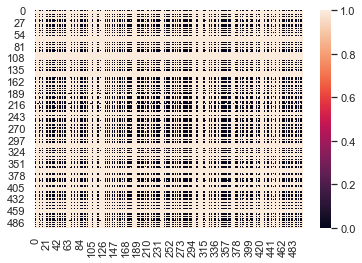

In [9]:
# visualise network with other radius

#print(np.nnz(geom_net_matr))
import numpy as np; np.random.seed(0)
import seaborn as sns; sns.set()

import matplotlib.pyplot as plt
%matplotlib inline

#uniform_data = np.random.rand(10, 12)
ax = sns.heatmap(geom_net_matr)
plt.show()



C:\Users\lyubo\Anaconda3\envs\default\lib\site-packages\networkx\drawing\nx_pylab.py:579: MatplotlibDeprecationWarning:


The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.



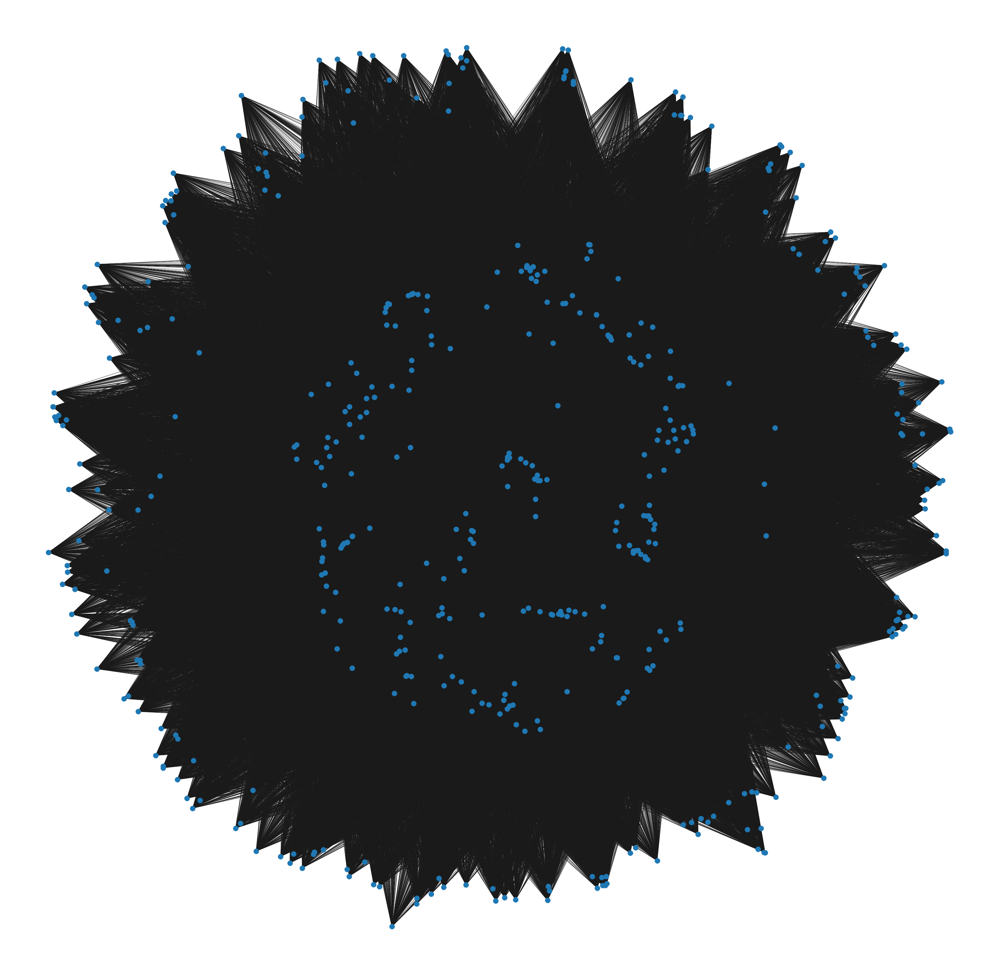

In [11]:
# Visualise network from adjacency matrix: R=100, N=1000 

import networkx as nx
from matplotlib import pyplot as plt # import matplotlib.pyplot as plt


# first we visualise it without any embeddings in 2D space
graph_geom = nx.from_numpy_matrix(geom_net_matr)
fig, ax = plt.subplots(figsize=(60, 60))
nx.draw(graph_geom) 
plt.show()

In [ ]:
# it is hard to compare networks so we plot at least degree distribution 

(25, 24, 23, 22, 21, 20, 19, 18, 17, 16, 15, 14, 13, 12, 11, 10, 9, 8, 7, 6, 5, 4)


Text(0.5, 0, 'Degree')

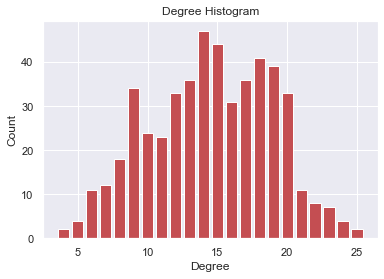

In [22]:
import collections
import matplotlib.pyplot as plt
import networkx as nx

graph_geom = nx.random_geometric_graph(500, 0.1)
degree_sequence = sorted([d for n, d in graph_geom.degree()], reverse=True)  # degree sequence
# print "Degree sequence", degree_sequence
degreeCount = collections.Counter(degree_sequence)
deg, cnt = zip(*degreeCount.items())
print(deg)

fig, ax = plt.subplots()
plt.bar(deg, cnt, width=0.80, color='r')

plt.title("Degree Histogram")
plt.ylabel("Count")
plt.xlabel("Degree")
#ax.set_xticks([d + 0.4 for d in deg])
#ax.set_xticklabels(deg)

### Plot geometric graph in 2d

Here we give example of how to analyze and plot geometric networks in 2D.

C:\Users\lyubo\Anaconda3\envs\default\lib\site-packages\networkx\drawing\nx_pylab.py:579: MatplotlibDeprecationWarning:


The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.



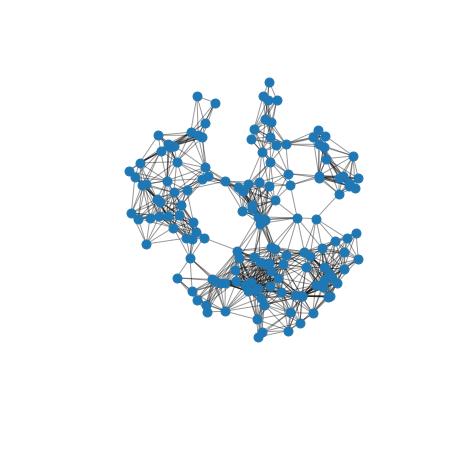

In [4]:
import networkx as nx
from matplotlib import pyplot as plt # import matplotlib.pyplot as plt


G = nx.random_geometric_graph(500, 0.1)
# or set geometric graph from data 
G = nx.from_numpy_matrix(geom_net_matr)

# position is stored as node attribute data for random_geometric_graph
pos = nx.get_node_attributes(G, 'pos')

dmin =1
ncenter =0
for n in pos:
    x,y = pos[n]
    d = (x-0.5)**2+(y-0.5)**2
    if d<dmin:
        ncenter = n
        dmin = d

# color by path length from node near center
p = {node:length
     for node, length in nx.single_source_shortest_path_length(G, ncenter).items()
     if length < 5}

plt.figure(figsize = (8, 8))

#node_color = p.values()
betw = nx.betweenness_centrality(G)

#color nodes according to values of betweenness 
H = G.subgraph(p.keys())    
nx.draw_networkx_edges(H, pos, alpha = 0.4)
nx.draw_networkx_nodes(H, pos, node_size = 80, #node_color = node_color,
                       cmap = plt.get_cmap('Reds_r'))



plt.xlim(-0.05, 1.05)
plt.ylim(-0.05, 1.05)
plt.axis('off')
#plt.savefig('random_geometric_graph.png')
plt.show()


### Study the data 

Count the number of feminim vs. masculin participants.

In [23]:
import matplotlib.pyplot as plt
%matplotlib inline

import pandas as pd
import numpy as np

f_num = df[df.gender == "m" ]
m_num = df[df.gender == "f"]

print(f_num)
print(m_num.shape)


Empty DataFrame
Columns: [id, time, time2, gender, lat, lon, sign, nan]
Index: []
(0, 8)


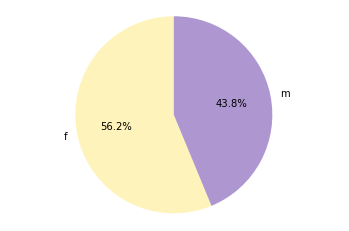

In [25]:
print(' This is just example')

subject_names = ['f', 'm'] #["Math", "Bangla" , "English", "Physics", "Chemistry"]
subject_marks = [90, 70]# 33, 68, 47]  ### This is just example

colors = ["#ffd50544", "#7952b399", "#ff222244", "#007bff44", "#262c3a44"]

plt.pie(subject_marks, labels = subject_names, autopct='%1.1f%%', startangle=90, colors=colors)
plt.axis('equal') 
plt.show()

# TODO from example do on real data 


### TODO 
0. Generate geometric graph based on coordinates (x_i, y_i) of users with radius R
1. Get matrix A from Samat
2. compare the geometric network and matrix A. 
3. study data info from example do on real data 